In [1]:
DEBUG = False

In [2]:
import sys
sys.path.append('../HPA-competition-solutions/bestfitting/src/')

In [3]:
import time
import skimage.io
import numpy as np
import pandas as pd
import cv2
import PIL.Image
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.optim import lr_scheduler
from torch.utils.data import DataLoader, Dataset
from torch.utils.data.sampler import SubsetRandomSampler, RandomSampler, SequentialSampler
from warmup_scheduler import GradualWarmupScheduler
from efficientnet_pytorch import model as enet
import albumentations
from iterstrat.ml_stratifiers import MultilabelStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import cohen_kappa_score
from tqdm import tqdm_notebook as tqdm
import os
import warnings
import cv2
from sklearn.metrics import average_precision_score
import pickle

warnings.filterwarnings('ignore') 

In [4]:
from config.config import *
from networks.densenet import *
from datasets.tool import *
from torch.utils.data import Dataset
import pandas as pd
import torchvision
import torch
import cv2
import os

import time
import shutil
from sklearn.metrics import f1_score

import torch
import torch.optim
from torch.utils.data import DataLoader
from torch.utils.data.sampler import RandomSampler, SequentialSampler
from torch.nn import DataParallel
from torch.backends import cudnn
import torch.nn.functional as F
from torch.autograd import Variable

from config.config import *
from utils.common_util import *
from networks.imageclsnet import init_network
from datasets.protein_dataset import ProteinDataset
from utils.augment_util import train_multi_augment2
from layers.loss import *
from layers.scheduler import *
from utils.log_util import Logger

run on pazur


In [5]:
kernel_type = 'bf_6'

fold = 0
image_size = 768
crop_size = 768
batch_size = 64
num_workers = 8
out_dim = 19
init_lr = 3e-4
warmup_factor = 10
nseed = 2 if DEBUG else 5
nfold = 2 if DEBUG else 5
seed = 42
test_image_size = 128

warmup_epo = 1
n_epochs = 3 if DEBUG else 3

device = torch.device('cuda')

In [6]:
df = pd.read_csv('../hpa_folds_v1.csv')

In [7]:
train_folder = '/media/darek/projects/hpa/train768'
public__folder = '/media/darek/projects/hpa/public768/hpa_public_excl_0_16_768/small'

df_t = df[df.dataset == 'train']
df_p = df[df.dataset == 'public']
df_t['fpath'] = df_t.ID.apply(lambda r: os.path.join(train_folder, r))
df_p['fpath'] = df_p.ID.apply(lambda r: os.path.join(public__folder, r))

df_train = pd.concat([df_t, df_p], ignore_index=True)
df_train.drop_duplicates(inplace=True)
df_train.reset_index(drop=True, inplace=True)
df_train['Label'] = df_train['Label'].astype(str)
df_train.head()

,ID,Label,dataset,fold,fpath
0,12d0e1dc-bbc7-11e8-b2bc-ac1f6b6435d0,14,train,4,/media/darek/projects/hpa/train768/12d0e1dc-bb...
1,836a3fb4-bba5-11e8-b2ba-ac1f6b6435d0,14,train,0,/media/darek/projects/hpa/train768/836a3fb4-bb...
2,5a474b22-bba5-11e8-b2ba-ac1f6b6435d0,5,train,1,/media/darek/projects/hpa/train768/5a474b22-bb...
3,a2a59eea-bba6-11e8-b2ba-ac1f6b6435d0,2,train,0,/media/darek/projects/hpa/train768/a2a59eea-bb...
4,d6118772-bba5-11e8-b2ba-ac1f6b6435d0,16|10|13,train,0,/media/darek/projects/hpa/train768/d6118772-bb...


In [8]:
df_train = df_train.sample(256).reset_index(drop=True) if DEBUG else df_train

In [9]:
labels = [str(i) for i in range(19)]
full_counts = {}
fsum = 0
for lbl in labels:
    count = 0
    for row_label in df_train['Label']:
        if lbl in row_label.split('|'): count += 1
    full_counts[lbl] = count
    fsum += count
full_counts['avg'] = int(fsum/(len(labels)))

counts = list(zip(full_counts.keys(), full_counts.values()))
counts = np.array(sorted(counts, key=lambda x:-x[1]))
counts = pd.DataFrame(counts, columns=['label', 'full_count'])
counts.set_index('label', inplace=True)
counts.T

label,0,17,13,14,16,18,7,2,avg,4,5,12,6,3,9,1,10,8,15,11
full_count,8797,6733,6443,6164,5685,5318,4381,3989,3503,3204,2593,2593,2219,1845,1682,1607,1543,1320,312,141


## Model

In [10]:
dm = torchvision.models.densenet121(pretrained=True)

In [11]:
class DensenetClass1(nn.Module):
    def load_pretrain(self, pretrain_file):

        # '.'s are no longer allowed in module names, but pervious _DenseLayer
        # has keys 'norm.1', 'relu.1', 'conv.1', 'norm.2', 'relu.2', 'conv.2'.
        # They are also in the checkpoints in model_urls. This pattern is used
        # to find such keys.
        pattern = re.compile(
            r'^(.*denselayer\d+\.(?:norm|relu|conv))\.((?:[12])\.(?:weight|bias|running_mean|running_var))$')
        state_dict = torch.load(pretrain_file)
        for key in list(state_dict.keys()):
            res = pattern.match(key)
            if res:
                new_key = res.group(1) + res.group(2)
                state_dict[new_key] = state_dict[key]
                del state_dict[key]
        self.backbone.load_state_dict(state_dict)

    def __init__(self,feature_net='densenet121', num_classes=28,
                 in_channels=3,
                 pretrained_file=None,
                 dropout=False,
                 large=False,
                 ):
        super().__init__()
        self.dropout = dropout
        self.in_channels = in_channels
        self.large = large

        if feature_net=='densenet121':
            self.backbone = densenet121()
            num_features = 1024
        elif feature_net=='densenet169':
            self.backbone = densenet169()
            num_features = 1664
        elif feature_net=='densenet161':
            self.backbone = densenet161()
            num_features = 2208
        elif feature_net=='densenet201':
            self.backbone = densenet201()
            num_features = 1920

        self.load_pretrain(pretrained_file)

        if self.in_channels > 3:
            # https://www.kaggle.com/iafoss/pretrained-resnet34-with-rgby-0-460-public-lb
            w = self.backbone.features.conv0.weight
            self.backbone.features.conv0 = nn.Conv2d(4, 64, kernel_size=(7,7), stride=(2,2), padding=(3, 3), bias=False)
            self.backbone.features.conv0.weight = torch.nn.Parameter(torch.cat((w, w[:,:1,:,:]),dim=1))

        self.conv1 =nn.Sequential(
            self.backbone.features.conv0,
            self.backbone.features.norm0,
            self.backbone.features.relu0,
            self.backbone.features.pool0
        )
        self.encoder2 = nn.Sequential(self.backbone.features.denseblock1,
                                      )
        self.encoder3 = nn.Sequential(self.backbone.features.transition1,
                                      self.backbone.features.denseblock2,
                                      )
        self.encoder4 = nn.Sequential(self.backbone.features.transition2,
                                      self.backbone.features.denseblock3,
                                      )
        self.encoder5 = nn.Sequential(self.backbone.features.transition3,
                                      self.backbone.features.denseblock4,
                                      self.backbone.features.norm5)
        self.avgpool = nn.AdaptiveAvgPool2d(1)
        self.maxpool = nn.MaxPool2d(2, stride=2)
        self.logit = nn.Linear(num_features, num_classes)

        self.bn1 = nn.BatchNorm1d(num_features*2)
        self.fc1 = nn.Linear(num_features*2, num_features)
        self.bn2 = nn.BatchNorm1d(num_features)
        self.relu = nn.ReLU(inplace=True)

    def forward(self, images, masks):
        mean = [0.074598, 0.050630, 0.050891, 0.076287]#rgby
        std =  [0.122813, 0.085745, 0.129882, 0.119411]
        for i in range(self.in_channels):
            images[:,i,:,:] = (images[:,i,:,:] - mean[i]) / std[i]

        x = self.conv1(images)
        e2 = self.encoder2(x)
        e3 = self.encoder3(e2)
        e4 = self.encoder4(e3)
        e5 = self.encoder5(e4) # [1, 1024, 24, 24]
        e5 = F.relu(e5,inplace=True)
        # GAP MASK STARTS HERE:
        e5 = F.interpolate(e5, scale_factor=2, mode='bilinear') # increase grid size to 48x48
        x = e5.permute(0,2,3,1) # [1, 48, 48, 1024]
        x = x.squeeze() # [48, 48, 1024]
        msk = masks.squeeze() # [15, 48, 48]
        
        res = msk[...,None] * x[None,...] # [15, 48, 48, 1024]
        res = res.permute(0,3,1,2)
        # NOW APPLY THE MODEL HEAD WITH THE MASK DIMENSION AS THE BATCH DIMENSION
        x = torch.cat((nn.AdaptiveAvgPool2d(1)(res), nn.AdaptiveMaxPool2d(1)(res)), dim=1)
        x = x.view(x.size(0), -1)
        
        x = self.bn1(x)
        x = F.dropout(x, p=0.5, training=self.training)
        x = self.fc1(x)
        x = self.relu(x)
        x = self.bn2(x)
        x = F.dropout(x, p=0.5, training=self.training)
        x = self.logit(x)

        return x

In [12]:
def class_densenet121_dropout1(**kwargs):
    num_classes = kwargs['num_classes']
    in_channels = kwargs['in_channels']
    pretrained_file = kwargs['pretrained_file']
    model = DensenetClass1(feature_net='densenet121', num_classes=num_classes,
                        in_channels=in_channels, pretrained_file=pretrained_file, dropout=True)
    return model

In [13]:
def get_model_test():
    model = class_densenet121_dropout1(num_classes=19, in_channels=4, pretrained_file='/home/darek/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth')
    return model

In [14]:
def get_model(n):
    
    model_file = f'/home/darek/Projects/HPA/protein_models/models/external_crop512_focal_slov_hardlog_class_densenet121_dropout_i768_aug2_5folds/fold{n}/final.pth'

    model = class_densenet121_dropout(num_classes=19, in_channels=4, pretrained_file='/home/darek/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth')
    weights = torch.load(model_file)
    pretrained_dict = weights['state_dict']
    model_dict = model.state_dict()

    # 1. filter out unnecessary keys
    pretrained_dict = {k: v for k, v in pretrained_dict.items() if k not in ['logit.weight', 'logit.bias']}
    # 2. overwrite entries in the existing state dict
    model_dict.update(pretrained_dict)
    # 3. load the new state dict
    model.load_state_dict(model_dict)

    i = 0
    for child in model.children():
        if i < 6:
            for param in child.parameters():
                param.requires_grad = False
        i += 1
    return model

In [15]:
def open_rgby(fpath, yellow=True): #a function that reads RGBY image    
    if yellow: colors = ['red','green','blue','yellow']
    else: colors = ['red','green','blue']
    flags = cv2.IMREAD_GRAYSCALE
    img = [cv2.imread(fpath+'_'+color+'.png', flags) for color in colors]
    
    return np.stack(img, axis=-1)

## Dataset

In [16]:
class HPADataset(Dataset):
    def __init__(self, df, transform=None):
        self.df = df.reset_index(drop=True)
        self.transform = transform

    def __len__(self):
        return self.df.shape[0]

    def __getitem__(self, index):
        row = self.df.iloc[index]
        fpath = row.fpath
        image = open_rgby(fpath)

        if self.transform is not None:
            image = self.transform(image=image)['image']
        image = image.astype(np.float32)
        image /= 255 #moved to albumentations normalize
        image = image.transpose(2, 0, 1)

        label = np.zeros(out_dim).astype(np.float32)
        img_lbls = [int(x) for x in row.Label.split('|')]
        for i in img_lbls: label[i] = 1.
        return torch.tensor(image), torch.tensor(label)

## Augmentations

In [17]:
from albumentations.core.transforms_interface import ImageOnlyTransform

class Gridify(ImageOnlyTransform):

    def __init__(
        self,
        grid_size=2048,
        always_apply=False,
        p=1.0,
    ):
        super(Gridify, self).__init__(always_apply, p)
        self.grid_size = grid_size
        self.transform = albumentations.Compose([
            albumentations.VerticalFlip(p=0.5),
            albumentations.HorizontalFlip(p=0.5),
        ])

    def apply(self, image, **params):
        grid = np.zeros((self.grid_size,self.grid_size, 4)).astype(np.uint8)
        ch,cw,_ = image.shape
        gh,gw,_ = grid.shape
        hsteps = np.ceil(gh/ch).astype(int)
        wsteps = np.ceil(gw/cw).astype(int)

        h,w = ch,cw
        hmargin = ch

        for i in range(hsteps):
            wmargin = cw
            h = ch * (i+1)
            if h > gh:
                hmargin = gh-h
                h = gh
            for j in range(wsteps):
                transformed = self.transform(image=image)
                transformed_image = transformed["image"]
                w = cw * (j+1)
                if w > gw:
                    wmargin = gw-w
                    w = gw
                grid[ch*i:h,cw*j:w,:] = transformed_image[:hmargin,:wmargin,:]
        return grid        

    def get_transform_init_args_names(self):
        return ("grid_size")

In [19]:
mean = (0.07237246, 0.04476176, 0.07661699)
std = (0.17179589, 0.10284516, 0.14199627)


transforms_train = albumentations.Compose([
    albumentations.Resize(image_size, image_size, p=1.),
    albumentations.RandomCrop(crop_size, crop_size, p=1.),
    albumentations.VerticalFlip(p=0.5),
    albumentations.HorizontalFlip(p=0.5),
    albumentations.RandomRotate90(p=0.5),
#     albumentations.RandomGridShuffle(grid=(3, 3), p=0.25),
#     albumentations.Normalize(mean=mean, std=std)
])

transforms_val = albumentations.Compose([
    albumentations.Resize(image_size, image_size, p=1.),
#     albumentations.RandomCrop(crop_size, crop_size, p=1.),
#     albumentations.Normalize(mean=mean, std=std)
])

transforms_test = albumentations.Compose([
    albumentations.LongestMaxSize(max_size=int(test_image_size)),
    albumentations.PadIfNeeded(min_height=int(test_image_size * 1.25), min_width=int(test_image_size * 1.25)),
#     albumentations.Normalize(mean=mean, std=std, max_pixel_value=255.0)
])

transforms_grid1 = albumentations.Compose([
    Gridify(grid_size=2048),
    albumentations.Resize(image_size, image_size, p=1.),
#     albumentations.Normalize(mean=mean, std=std)
])
transforms_grid2 = albumentations.Compose([
    Gridify(grid_size=1728),
    albumentations.Resize(image_size, image_size, p=1.),
#     albumentations.Normalize(mean=mean, std=std)
])
transforms_grid3 = albumentations.Compose([
    Gridify(grid_size=3072),
    albumentations.Resize(image_size, image_size, p=1.),
#     albumentations.Normalize(mean=mean, std=std)
])

In [20]:
class UnNormalize(object):
    def __init__(self, mean, std):
        self.mean = mean
        self.std = std
    def __call__(self, tensor):
#         for t, m, s in zip(tensor, self.mean, self.std):
#             t.mul_(s).add_(m)
        return tensor

In [21]:
def tensor2label(t):
    l = t.numpy().tolist()
    l = [i for i,v in enumerate(l) if v==1.]
    return str(l)
label = torch.tensor(np.array([1.,0,1,0]))
tensor2label(label)

'[0, 2]'

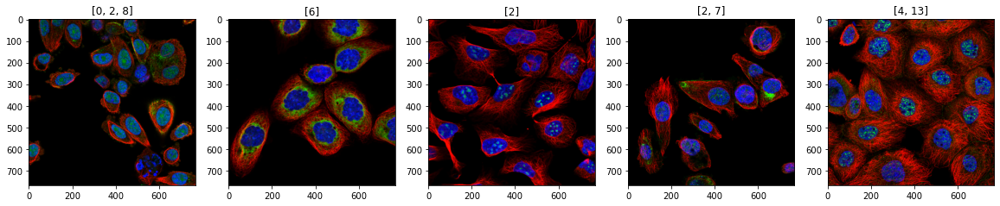

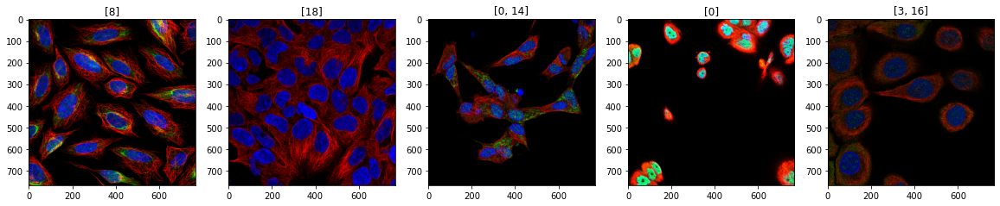

In [22]:
unnorm = UnNormalize(mean, std)
dataset_show = HPADataset(df_train, transform=transforms_train)
from pylab import rcParams
rcParams['figure.figsize'] = 20,10
for i in range(2):
    f, axarr = plt.subplots(1,5)
    for p in range(5):
        idx = np.random.randint(0, len(dataset_show))
        img, label = dataset_show[idx]
        img = unnorm(img)[:3,:,:]
        axarr[p].imshow(img.transpose(0, 1).transpose(1,2).squeeze())
        axarr[p].set_title(tensor2label(label))

## Mask dataset

In [23]:
def read_rgby_test(img_id):
    img_dir = '../full_test/test'
    msk_dir = '../test_masks/work/cell_masks'
    suffix = '.png'
    colors = ['red', 'green', 'blue', 'yellow']
    flags = cv2.IMREAD_GRAYSCALE
    img = [cv2.imread(opj(img_dir, img_id + '_' + color + suffix), flags)
           for color in colors]
    img = np.stack(img, axis=-1)
    msk = np.load(opj(msk_dir, img_id + '.npz'))['arr_0'].astype('int8')
    return img, msk

In [24]:
import base64
import numpy as np
from pycocotools import _mask as coco_mask
import typing as t
import zlib


def encode_binary_mask(mask: np.ndarray) -> t.Text:
  """Converts a binary mask into OID challenge encoding ascii text."""

  # check input mask --
  if mask.dtype != np.bool:
    raise ValueError(
        "encode_binary_mask expects a binary mask, received dtype == %s" %
        mask.dtype)

  mask = np.squeeze(mask)
  if len(mask.shape) != 2:
    raise ValueError(
        "encode_binary_mask expects a 2d mask, received shape == %s" %
        mask.shape)

  # convert input mask to expected COCO API input --
  mask_to_encode = mask.reshape(mask.shape[0], mask.shape[1], 1)
  mask_to_encode = mask_to_encode.astype(np.uint8)
  mask_to_encode = np.asfortranarray(mask_to_encode)

  # RLE encode mask --
  encoded_mask = coco_mask.encode(mask_to_encode)[0]["counts"]

  # compress and base64 encoding --
  binary_str = zlib.compress(encoded_mask, zlib.Z_BEST_COMPRESSION)
  base64_str = base64.b64encode(binary_str)
  return base64_str.decode('ascii')

In [25]:
def encodings_from_mask(mask):
    encs = []
    for j in range(1, np.max(mask) + 1):
        bmask = (mask == j)
        enc = encode_binary_mask(bmask)
        encs.append(enc)
    return encs

In [26]:
def convert_mask(mask):
    bmask = np.zeros((np.max(mask), mask.shape[0], mask.shape[1]))
    for j in range(1, np.max(mask) + 1):
        bmask[j-1] = (mask == j)
    return bmask    

In [33]:
class ProteinTestDataset(Dataset):
    def __init__(self,
                 test_df,
                 img_size=512,
                 transform=None,
                 in_channels=4,
                 return_encodings=False
                 ):
        self.test_df = test_df
        self.img_size = img_size
        self.in_channels = in_channels
        self.transform = transform
        self.return_encodings = return_encodings

    def __getitem__(self, index):
        img_id = self.test_df.ID.loc[index]
        image, mask = read_rgby_test(img_id)
        image = cv2.resize(image, (768,768))
        image = image / 255.0
        image = image_to_tensor(image)
        if self.return_encodings:
            encs = encodings_from_mask(mask)
        mask = cv2.resize(mask, (768,768), interpolation=cv2.INTER_NEAREST)
        mask = convert_mask(mask)
        mask = mask.transpose(1,2,0)
        mask = cv2.resize(mask, (48,48), interpolation=cv2.INTER_NEAREST)
        mask = mask.transpose(2,0,1)
        mask = torch.Tensor(mask)
        if self.return_encodings:
            return {
                'image': image, 
                'mask': mask,
                'encoding': encs,
            }
        return {
            'image': image, 
            'mask': mask,
        }

    def __len__(self):
        return len(self.test_df)

In [34]:
df = pd.read_csv('../sample_submission.csv')
df.head()

,ID,ImageWidth,ImageHeight,PredictionString
0,0040581b-f1f2-4fbe-b043-b6bfea5404bb,2048,2048,0 1 eNoLCAgIMAEABJkBdQ==
1,004a270d-34a2-4d60-bbe4-365fca868193,2048,2048,0 1 eNoLCAgIMAEABJkBdQ==
2,00537262-883c-4b37-a3a1-a4931b6faea5,2048,2048,0 1 eNoLCAgIMAEABJkBdQ==
3,00c9a1c9-2f06-476f-8b0d-6d01032874a2,2048,2048,0 1 eNoLCAgIMAEABJkBdQ==
4,0173029a-161d-40ef-af28-2342915b22fb,3072,3072,0 1 eNoLCAgIsAQABJ4Beg==


In [35]:
test_dataset_enc = ProteinTestDataset(
    df,
    return_encodings=True
)
test_loader_enc = torch.utils.data.DataLoader(
    test_dataset_enc,
    sampler=torch.utils.data.SequentialSampler(test_dataset_enc),
    batch_size=1,
    drop_last=False,
    num_workers=2,
    pin_memory=True,
)

test_dataset = ProteinTestDataset(
    df,
    return_encodings=False
)
test_loader = torch.utils.data.DataLoader(
    test_dataset,
    sampler=torch.utils.data.SequentialSampler(test_dataset),
    batch_size=1,
    drop_last=False,
    num_workers=2,
    pin_memory=True,
)

## Test Inference

In [36]:
model_dir = '.'

In [37]:
def load_models(model_files):
    models = []
    for model_f in model_files:
        model_f = os.path.join(model_dir, model_f)
        model = get_model_test()
        model.load_state_dict(torch.load(model_f, map_location=lambda storage, loc: storage), strict=True)
        model.eval()
        model.to(device)
        models.append(model)
        print(f'{model_f} loaded!')
    return models

model_files = []

epoch_eval = 5
for seed in range(nseed):
#     for fold in range(nfold):
    fold = seed
    mf = f'{kernel_type}_model_seed_{seed}_fold_{fold}_epoch_{epoch_eval}.pth'
    model_files.append(mf)

models = load_models(model_files)

./bf_6_model_seed_0_fold_0_epoch_5.pth loaded!
./bf_6_model_seed_1_fold_1_epoch_5.pth loaded!
./bf_6_model_seed_2_fold_2_epoch_5.pth loaded!
./bf_6_model_seed_3_fold_3_epoch_5.pth loaded!
./bf_6_model_seed_4_fold_4_epoch_5.pth loaded!


In [38]:
fold_probs = []

for fold in range(len(models)):
    model = models[fold]
    model.cuda()
    model.eval()  
    all_probs = []
    
    if fold == 0:
        loader = test_loader_enc
        all_encs = []
    else: 
        loader = test_loader
    
    for it, iter_data in tqdm(enumerate(loader, 0), total=len(loader)):
        images = iter_data['image'].cuda()
        masks = iter_data['mask'].cuda()
        if fold == 0:
            encs = iter_data['encoding']
            all_encs.append(encs)
        outputs = model(images, masks)
        logits = outputs
        probs = F.sigmoid(logits).data.cpu().numpy()
        all_probs.append(probs)
        
    fold_probs.append(all_probs)

  0%|          | 0/559 [00:00<?, ?it/s]

  0%|          | 0/559 [00:00<?, ?it/s]

  0%|          | 0/559 [00:00<?, ?it/s]

  0%|          | 0/559 [00:00<?, ?it/s]

  0%|          | 0/559 [00:00<?, ?it/s]

In [39]:
folds = list(zip(*fold_probs))

In [40]:
folds = [np.stack(folds[i]).mean(axis=0) for i in range(len(folds))]

In [41]:
encs = [enc[j][0] for enc in all_encs for j in range(len(enc))]
len(encs)

10716

In [42]:
cells = [len(enc) for enc in all_encs]
len(cells)

559

In [43]:
preds = folds
preds = [np.array(preds[i].tolist()[j]) for i in range(len(preds)) for j in range(preds[i].shape[0]) ]
preds = np.stack(preds)
preds.shape

(10716, 19)

In [44]:
preds = torch.Tensor(preds)

In [45]:
test_image_folder = '/media/darek/projects/hpa/testrgby/test_cells/test_cells'
test_df = pd.read_csv('/media/darek/projects/hpa/testrgby/test_cell_df.csv')
test_df.head()

,image_id,cell_id,size1,size2,enc
0,0040581b-f1f2-4fbe-b043-b6bfea5404bb,1,342,1050,eNqtVm2PojAQ/ksMZe+Sy21yubtc4gKDIkpBUJQ3KyD//9...
1,0040581b-f1f2-4fbe-b043-b6bfea5404bb,2,762,680,eNrVUm1PwkAM/kvt3XgRjEajvO7uhGCEEHCgcSQi/v9vXt...
2,0040581b-f1f2-4fbe-b043-b6bfea5404bb,3,398,470,eNoLCEgJMg4wDMg3NPQ39Df2NfaF0EZ+IBoBIXzc8oSgAR...
3,0040581b-f1f2-4fbe-b043-b6bfea5404bb,4,372,344,eNptUstOAzEM/CUnXtoiAQcegnbzOMAFgdRFbIXEpf9/q+...
4,0040581b-f1f2-4fbe-b043-b6bfea5404bb,5,544,244,eNp9UcuSmzAQ/CVGku1U8CGpxBs7EsMrPNdgMNYasIH/v0...


In [46]:
len(test_df)

10716

In [47]:
iids = df.ID.values
iids = [iids[i] for i in range(559) for j in range(cells[i])]
iids[-5:]
len(iids)

10716

In [48]:
test_df.image_id.values.tolist() == iids

True

In [49]:
class HPATestDataset(Dataset):
    def __init__(self, df, transform=None):
        self.df = df.reset_index(drop=True)
        self.transform = transform

    def __len__(self):
        return self.df.shape[0]

    def __getitem__(self, index):
        row = self.df.iloc[index]
        img_id = row.image_id
        cell_id = row.cell_id
        cell_image_id = str(img_id) + '_' + str(cell_id)
        fpath = os.path.join(test_image_folder, cell_image_id)
        image = open_rgby(fpath)

        if self.transform is not None:
            image = self.transform(image=image)['image']
        image = image.astype(np.float32)
        image /= 255
        image = image.transpose(2, 0, 1)

        return torch.tensor(image)

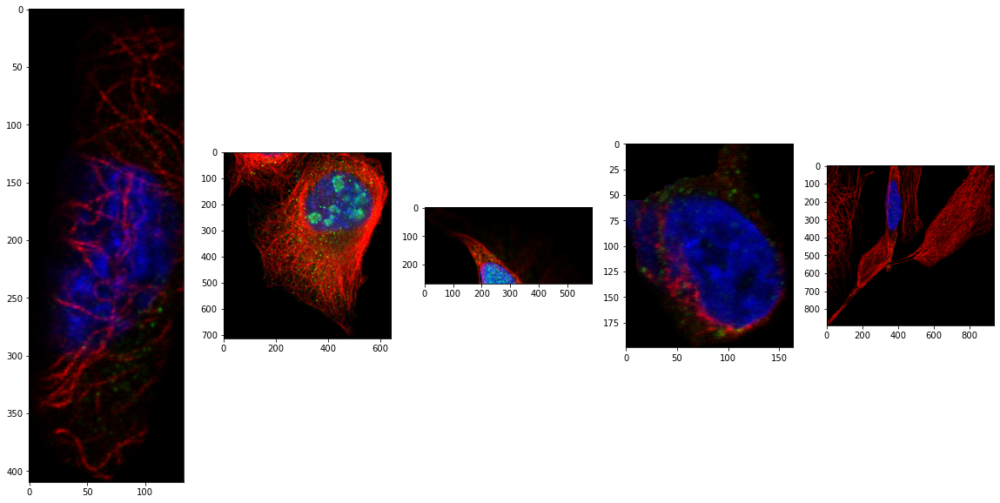

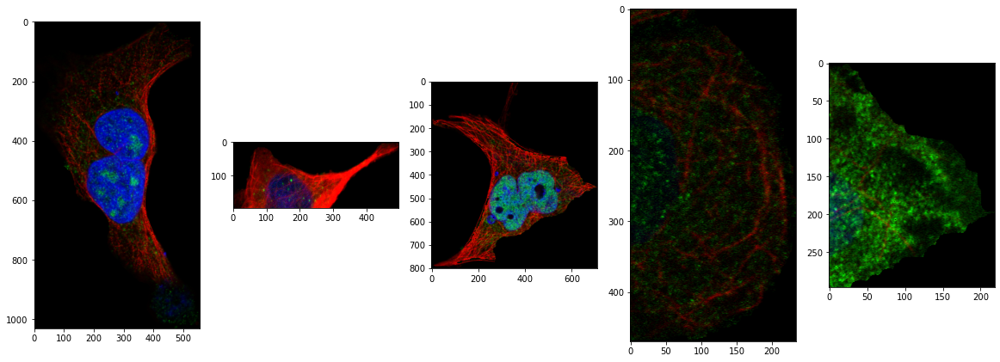

In [50]:
dataset_show = HPATestDataset(test_df, transform=None)
from pylab import rcParams
rcParams['figure.figsize'] = 20,10
for i in range(2):
    f, axarr = plt.subplots(1,5)
    for p in range(5):
        idx = np.random.randint(0, len(dataset_show))
        img = dataset_show[idx]
        img = unnorm(img)[:3,:,:]
        axarr[p].imshow(img.transpose(0, 1).transpose(1,2).squeeze())

In [51]:
AVG_LOGITS = preds

In [52]:
with open('logits_GAPmask_48x48_size768.pickle', 'wb') as handle:
    pickle.dump(AVG_LOGITS, handle)

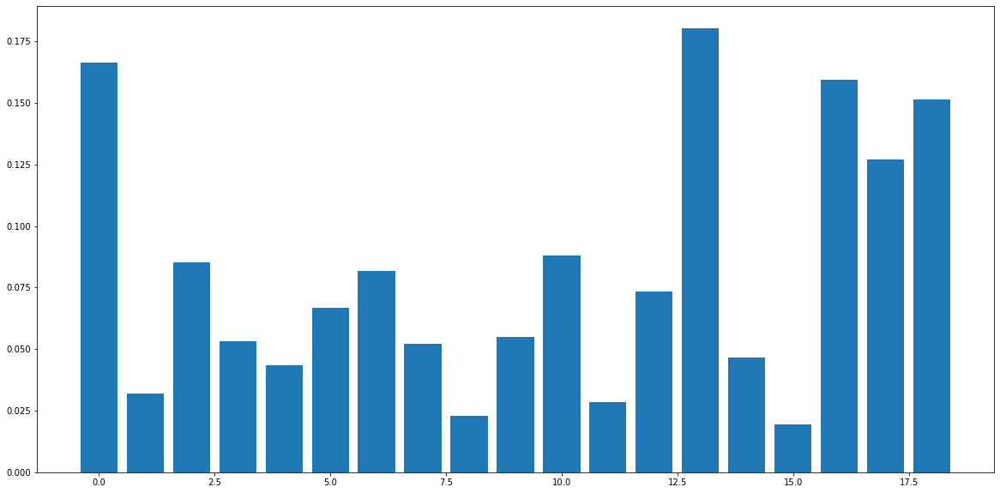

In [53]:
class_means = AVG_LOGITS.mean(dim=0).numpy()
labels = range(19)
plt.bar(labels, class_means)
plt.show()

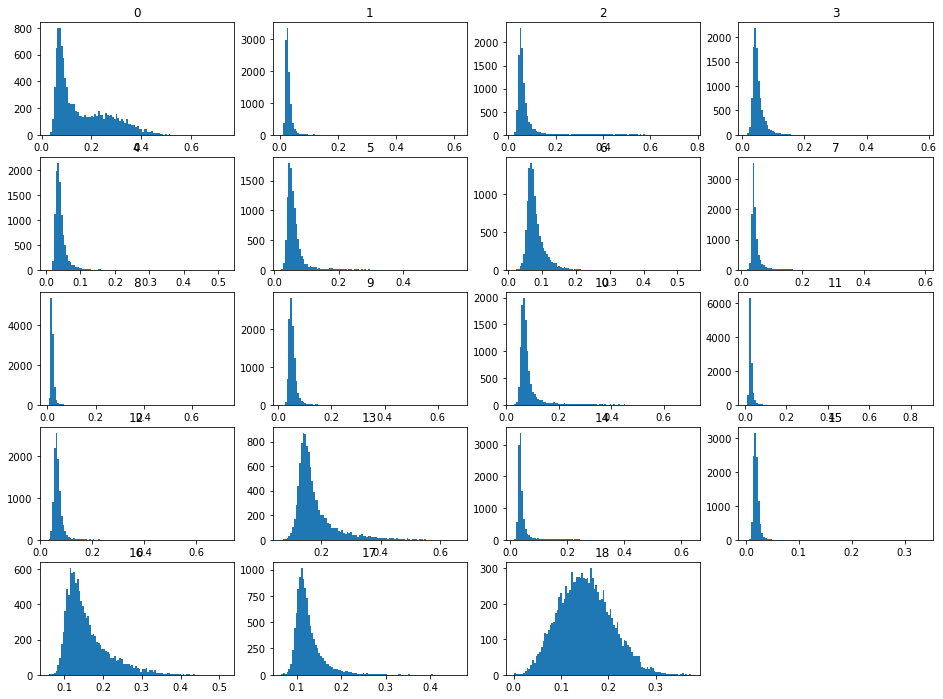

In [54]:
fig = plt.figure(figsize=(16, 12))

for i in labels:
    ax = fig.add_subplot(5,4,i+1)
    ax.hist(AVG_LOGITS[:,i].numpy(), bins=100)
    ax.set_title(i)

plt.show()

In [55]:
top_preds = AVG_LOGITS.argmax(dim=0).tolist()
top_kpreds = (-AVG_LOGITS).argsort(dim=0)[:6]
top30preds = (-AVG_LOGITS).argsort(dim=0)[30:33]
last_preds = (-AVG_LOGITS).argsort(dim=0)[-3:]
othe_preds = torch.cat([top30preds, last_preds], dim=0)
top_kvals = [[AVG_LOGITS[top_kpreds[i,j],j] for i in range(6)] for j in range(19)]
othe_vals = [[AVG_LOGITS[othe_preds[i,j],j] for i in range(6)] for j in range(19)]

In [56]:
HPA_LABEL_NAMES = {
    0: 'Nucleoplasm',
    1: 'Nuclear membrane',
    2: 'Nucleoli',
    3: 'Nucleoli fibrillar center',
    4: 'Nuclear speckles',
    5: 'Nuclear bodies',
    6: 'Endoplasmic reticulum',
    7: 'Golgi apparatus',
    8: 'Intermediate filaments',
    9: 'Actin filaments',
    10: 'Microtubules',
    11: 'Mitotic spindle',
    12: 'Centrosome',
    13: 'Plasma membrane',
    14: 'Mitochondria',
    15: 'Aggresome',
    16: 'Cytosol',
    17: 'Vesicles and punctate cytosolic patterns',
    18: 'Negative'
}

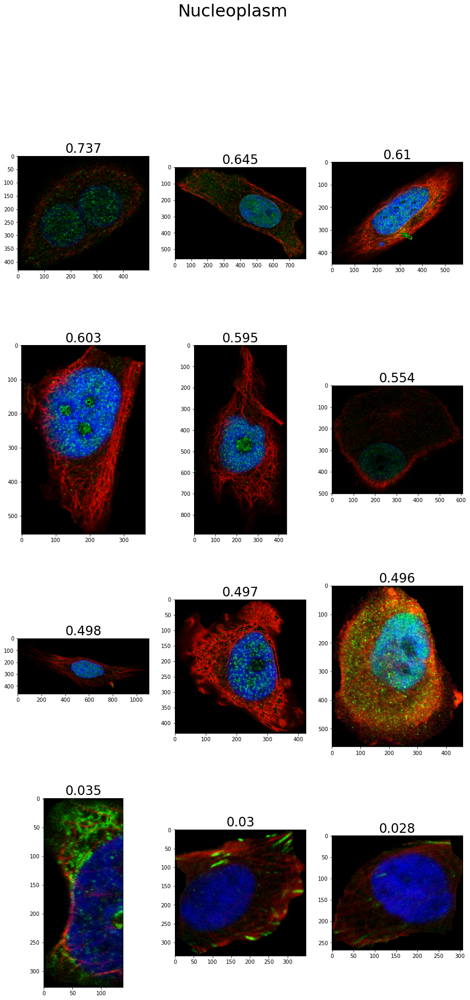

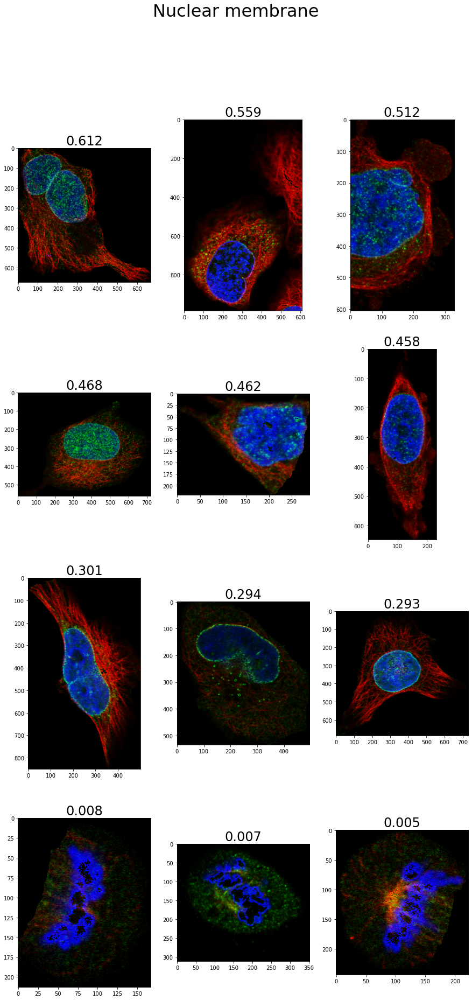

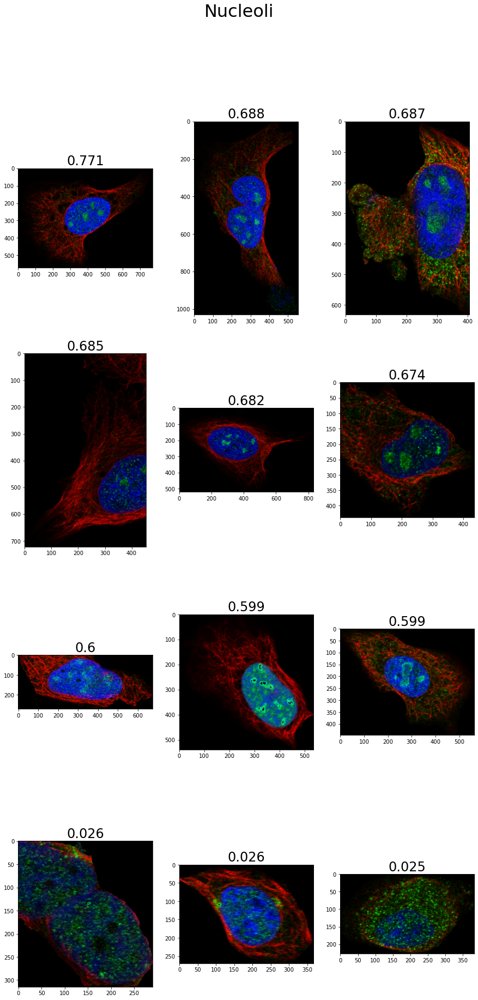

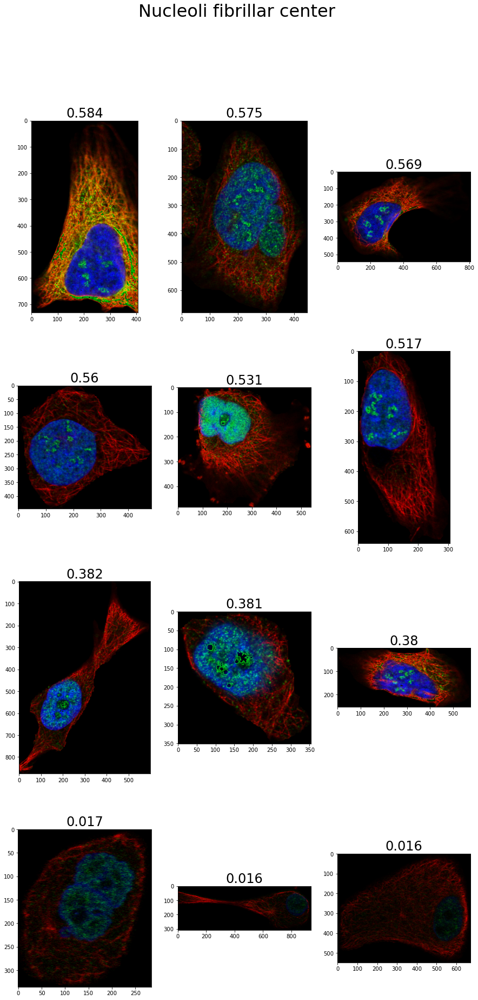

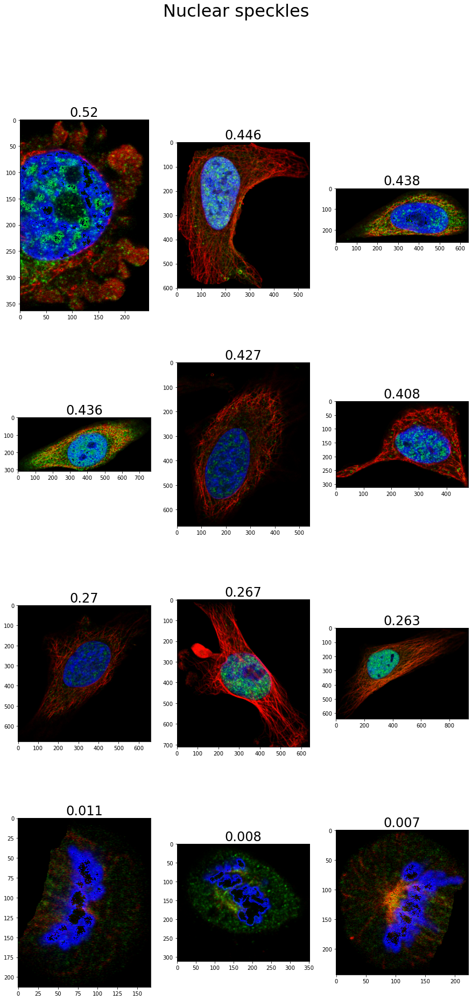

...

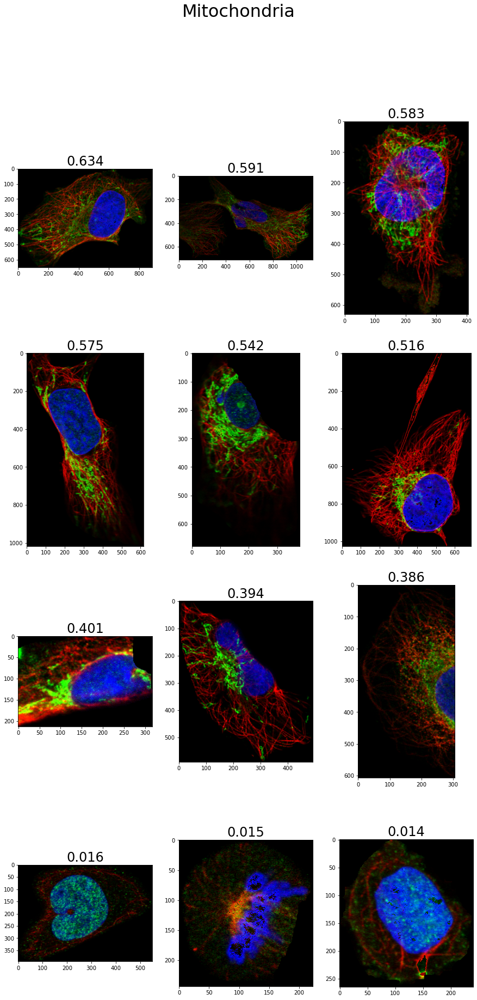

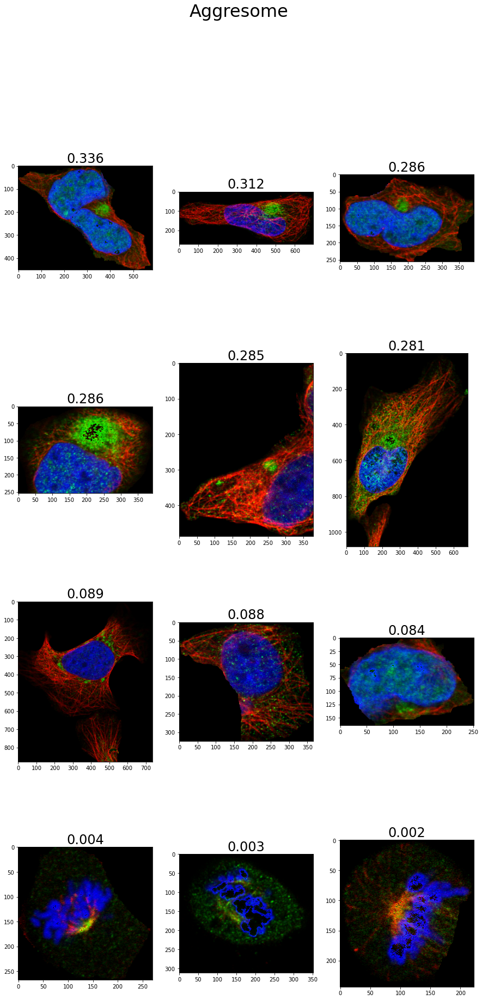

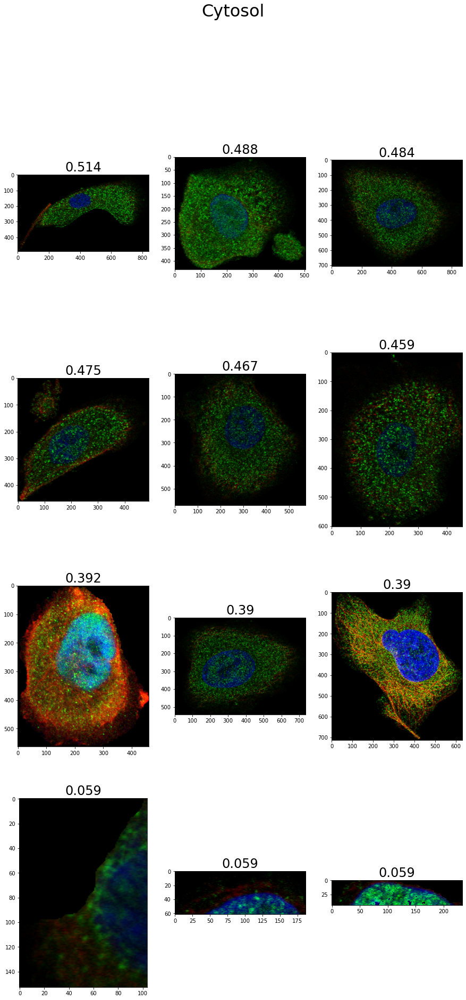

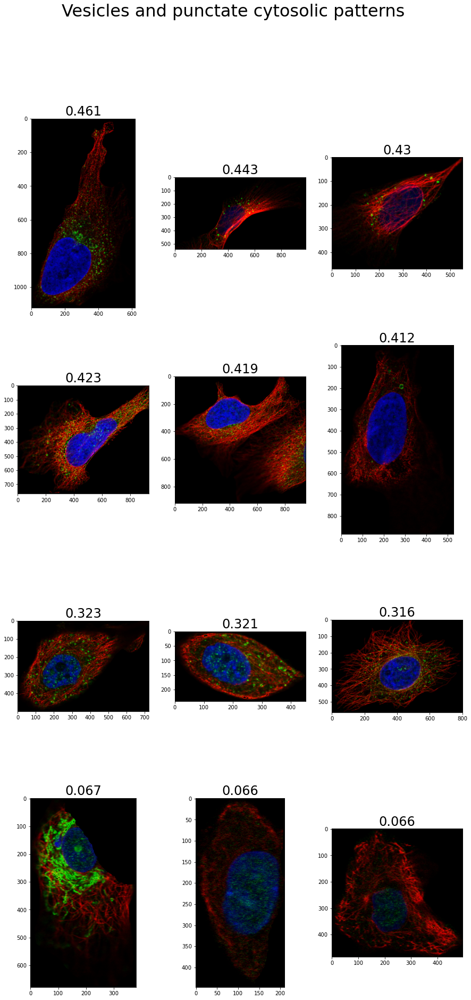

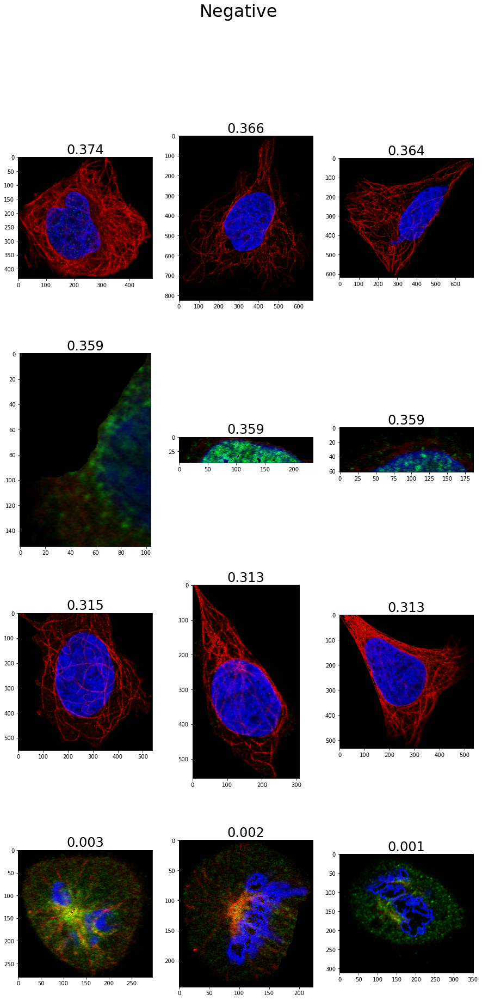

In [57]:
dataset_show = HPATestDataset(test_df, transform=None)
from pylab import rcParams
rcParams['figure.figsize'] = 15,30
rcParams['figure.titlesize'] = 32
rcParams['axes.titlesize'] = 24
rcParams['axes.labelsize'] = 20

for i in range(19):
    f, axarr = plt.subplots(4,3)
    f.suptitle(f'{HPA_LABEL_NAMES[i]}')
    for p in range(3):
        idx = top_kpreds[p,i].item()
        img = dataset_show[idx][:3]
        img = unnorm(img)
        axarr[0,p].imshow(img.transpose(0, 1).transpose(1,2).squeeze())
        axarr[0,p].title.set_text(f'{np.round(top_kvals[i][p].item(), 3)}')
    for p in range(3):
        idx = top_kpreds[p+3,i].item()
        img = dataset_show[idx][:3]
        img = unnorm(img)
        axarr[1,p].imshow(img.transpose(0, 1).transpose(1,2).squeeze())
        axarr[1,p].title.set_text(f'{np.round(top_kvals[i][p+3].item(), 3)}')
    for p in range(3):
        idx = othe_preds[p,i].item()
        img = dataset_show[idx][:3]
        img = unnorm(img)
        axarr[2,p].imshow(img.transpose(0, 1).transpose(1,2).squeeze())
        axarr[2,p].title.set_text(f'{np.round(othe_vals[i][p].item(), 3)}')
    for p in range(3):
        idx = othe_preds[p+3,i].item()
        img = dataset_show[idx][:3]
        img = unnorm(img)
        axarr[3,p].imshow(img.transpose(0, 1).transpose(1,2).squeeze())
        axarr[3,p].title.set_text(f'{np.round(othe_vals[i][p+3].item(), 3)}')